In [1]:
# Copyright 2025 Bytedance Ltd. and/or its affiliates.
# SPDX-License-Identifier: Apache-2.0

%load_ext autoreload
%autoreload 2

import os
# os.environ["CUDA_VISIBLE_DEVICES"] = "4,5,6"
from copy import deepcopy
from typing import (
    Any,
    AsyncIterable,
    Callable,
    Dict,
    Generator,
    List,
    NamedTuple,
    Optional,
    Tuple,
    Union,
)
import requests
from io import BytesIO

from PIL import Image
import torch
from accelerate import infer_auto_device_map, load_checkpoint_and_dispatch, init_empty_weights

from data.transforms import ImageTransform
from data.data_utils import pil_img2rgb, add_special_tokens
from modeling.bagel import (
    BagelConfig, Bagel, Qwen2Config, Qwen2ForCausalLM, SiglipVisionConfig, SiglipVisionModel
)
from modeling.qwen2 import Qwen2Tokenizer
from modeling.bagel.qwen2_navit import NaiveCache
from modeling.autoencoder import load_ae
from safetensors.torch import load_file

from huggingface_hub import snapshot_download

save_dir = "/checkpoint/dream_v2/transfusion/BAGEL-7B-MoT"
# repo_id = "ByteDance-Seed/BAGEL-7B-MoT"
# cache_dir = save_dir + "/cache"

# snapshot_download(cache_dir=cache_dir,
#   local_dir=save_dir,
#   repo_id=repo_id,
#   local_dir_use_symlinks=False,
#   resume_download=True,
#   allow_patterns=["*.json", "*.safetensors", "*.bin", "*.py", "*.md", "*.txt"],
# )
model_path = save_dir  # Download from https://huggingface.co/ByteDance-Seed/BAGEL-7B-MoT

# LLM config preparing
llm_config = Qwen2Config.from_json_file(os.path.join(model_path, "llm_config.json"))
llm_config.qk_norm = True
llm_config.tie_word_embeddings = False
llm_config.layer_module = "Qwen2MoTDecoderLayer"

# ViT config preparing
vit_config = SiglipVisionConfig.from_json_file(os.path.join(model_path, "vit_config.json"))
vit_config.rope = False
vit_config.num_hidden_layers = vit_config.num_hidden_layers - 1

# VAE loading
vae_model, vae_config = load_ae(local_path=os.path.join(model_path, "ae.safetensors"))

# Bagel config preparing
config = BagelConfig(
    visual_gen=True,
    visual_und=True,
    llm_config=llm_config, 
    vit_config=vit_config,
    vae_config=vae_config,
    vit_max_num_patch_per_side=70,
    connector_act='gelu_pytorch_tanh',
    latent_patch_size=2,
    max_latent_size=64,
)

with init_empty_weights():
    language_model = Qwen2ForCausalLM(llm_config)
    vit_model      = SiglipVisionModel(vit_config)
    model          = Bagel(language_model, vit_model, config)
    model.vit_model.vision_model.embeddings.convert_conv2d_to_linear(vit_config, meta=True)

# Tokenizer Preparing
tokenizer = Qwen2Tokenizer.from_pretrained(model_path)
tokenizer, new_token_ids, _ = add_special_tokens(tokenizer)

# Image Transform Preparing
vae_transform = ImageTransform(1024, 512, 16)
vit_transform = ImageTransform(980, 224, 14)

In [2]:
max_mem_per_gpu = "80GiB"  # Modify it according to your GPU setting. On an A100, 80 GiB is sufficient to load on a single GPU.

device_map = infer_auto_device_map(
    model,
    max_memory={i: max_mem_per_gpu for i in range(torch.cuda.device_count())},
    no_split_module_classes=["Bagel", "Qwen2MoTDecoderLayer"],
)
print(device_map)

same_device_modules = [
    'language_model.model.embed_tokens',
    'time_embedder',
    'latent_pos_embed',
    'vae2llm',
    'llm2vae',
    'connector',
    'vit_pos_embed'
]

if torch.cuda.device_count() == 1:
    first_device = device_map.get(same_device_modules[0], "cuda:0")
    for k in same_device_modules:
        if k in device_map:
            device_map[k] = first_device
        else:
            device_map[k] = "cuda:0"
else:
    first_device = device_map.get(same_device_modules[0])
    for k in same_device_modules:
        if k in device_map:
            device_map[k] = first_device

# Thanks @onion-liu: https://github.com/ByteDance-Seed/Bagel/pull/8
model = load_checkpoint_and_dispatch(
    model,
    checkpoint=os.path.join(model_path, "ema.safetensors"),
    device_map=device_map,
    offload_buffers=True,
    dtype=torch.bfloat16,
    force_hooks=True,
    offload_folder="/tmp/offload"
)

model = model.eval()
print('Model loaded')

OrderedDict([('', 0)])


The safetensors archive passed at /checkpoint/dream_v2/transfusion/BAGEL-7B-MoT/ema.safetensors does not contain metadata. Make sure to save your model with the `save_pretrained` method. Defaulting to 'pt' metadata.


Model loaded


In [ ]:
from inferencer import InterleaveInferencer
import random
import numpy as np

inferencer = InterleaveInferencer(
    model=model, 
    vae_model=vae_model, 
    tokenizer=tokenizer, 
    vae_transform=vae_transform, 
    vit_transform=vit_transform, 
    new_token_ids=new_token_ids
)

seed = 42
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
if torch.cuda.is_available():
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

## Image Generation

In [4]:
t2i_params =dict(
    cfg_text_scale=4.0,
    cfg_img_scale=1.0,
    cfg_interval=[0.4, 1.0],
    timestep_shift=3.0,
    num_timesteps=50,
    cfg_renorm_min=0.0,
    cfg_renorm_type="global",
)

# # "Stress test" with increasingly complex prompts
# prompts = [
#     # "a blue and white mug of coffee",
#     "a blue and white mug of coffee with a spoon inside",
#     "a blue and white mug of coffee with a spoon inside sitting on a white saucer on a wooden table",
#     "a blue and white mug of coffee with a spoon inside sitting on a white saucer on a wooden table with a stack of books next to it",
#     "a blue and white mug of coffee with a spoon inside sitting on a white saucer on a wooden table with a stack of books next to it and a small vase with flowers on the table",
#     "a blue and white mug of coffee with a spoon inside sitting on a white saucer on a wooden table with a stack of books next to it and a small vase with flowers on the table. An orange cat sits on the table in front of the coffee."
# ]

## Image Generation with Think

In [5]:
t2i_think_params =dict(
    think=True,
    max_think_token_n=1000,
    do_sample=False,
    # text_temperature=0.3,
    cfg_text_scale=4.0,
    cfg_img_scale=1.0,
    cfg_interval=[0.4, 1.0],
    timestep_shift=3.0,
    num_timesteps=50,
    cfg_renorm_min=0.0,
    cfg_renorm_type="global",
)

## Relative Position Weakness 

An orange cat sitting in front of a coffee cup on a table.
----------


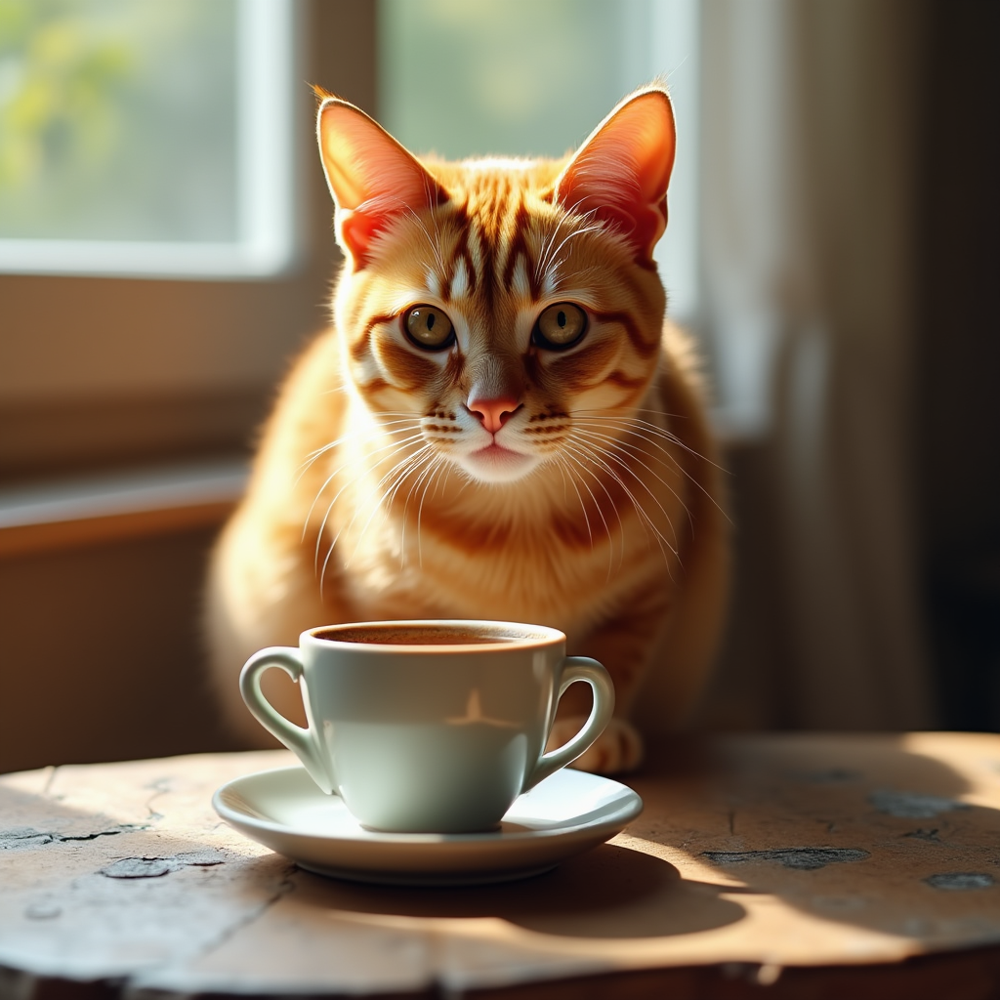

Thinking: <think>
The model should generate an image where the orange cat is positioned directly in front of the coffee cup, creating a sense of proximity and interaction.
The complete, polished prompt is: An ultra-realistic image of an orange cat sitting directly in front of a ceramic coffee cup on a wooden table, with the cat's body and face clearly visible and in sharp focus. The coffee cup is placed on a saucer, and the scene is lit with soft, natural daylight streaming in from a nearby window, creating gentle shadows and a warm, inviting atmosphere. The table surface is textured and slightly worn, adding a cozy, lived-in feel to the setting. The cat's fur is detailed and vibrant, with a glossy sheen, while the coffee cup has a simple yet elegant design, emphasizing the interaction between the two subjects. The overall composition is balanced and intimate, with a shallow depth of field creating a subtle bokeh effect in the background.
</think>


In [6]:
prompt = 'An orange cat sitting in front of a coffee cup on a table.'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")

A coffee cup behind an orange cat on a table
----------


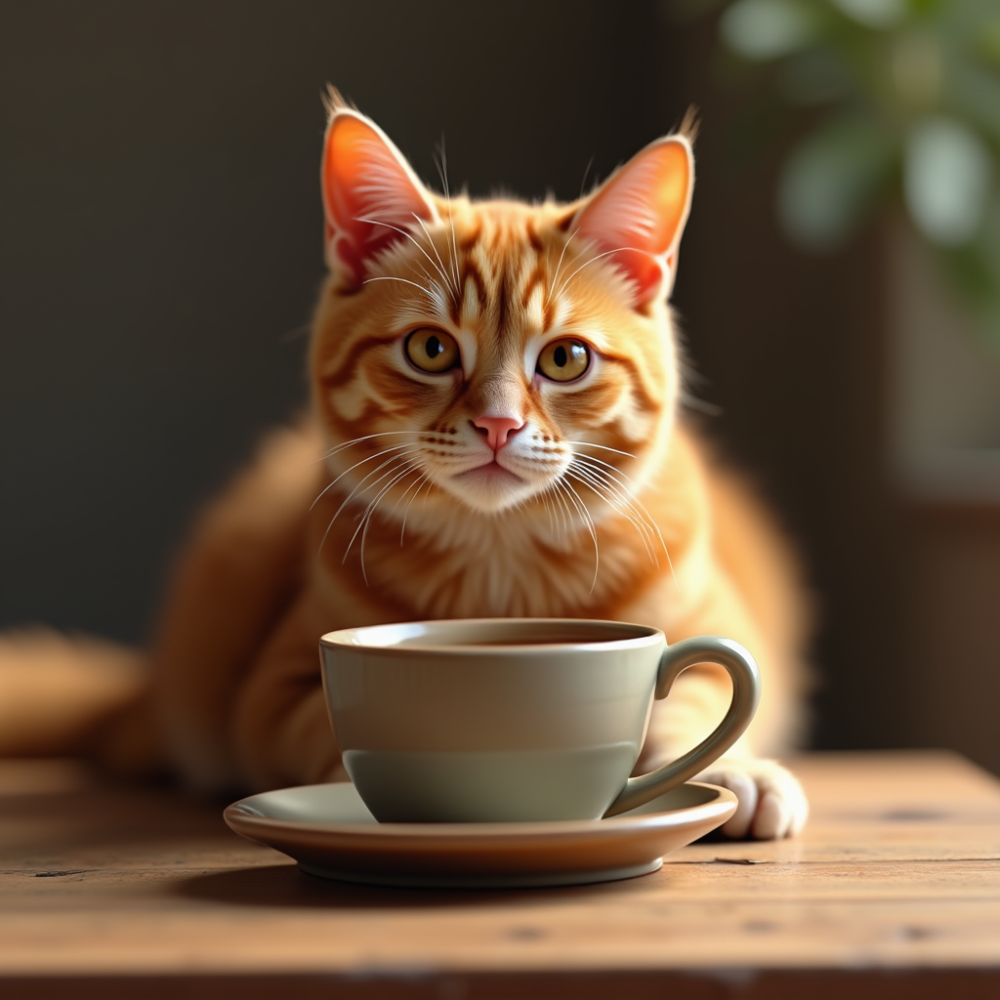

Thinking: <think>
The model should generate an image where the orange cat is positioned in front of the coffee cup, partially obscuring it, demonstrating occlusion.
The complete, polished prompt is: An ultra-realistic image of an orange cat sitting on a wooden table, positioned in front of a ceramic coffee cup, partially obscuring it to demonstrate clear occlusion. The cat's fur is vibrant and detailed, with soft lighting highlighting its texture, while the coffee cup is simple and earthy-toned, placed slightly behind the cat. The table surface is smooth and slightly worn, with a warm, natural ambiance created by soft, diffused lighting. The scene is captured with a shallow depth of field, creating a gentle bokeh effect in the background, emphasizing the cat and the coffee cup as the focal points.
</think>


In [7]:
prompt = 'A coffee cup behind an orange cat on a table'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")

A dog lying down to the right of some socks.
----------


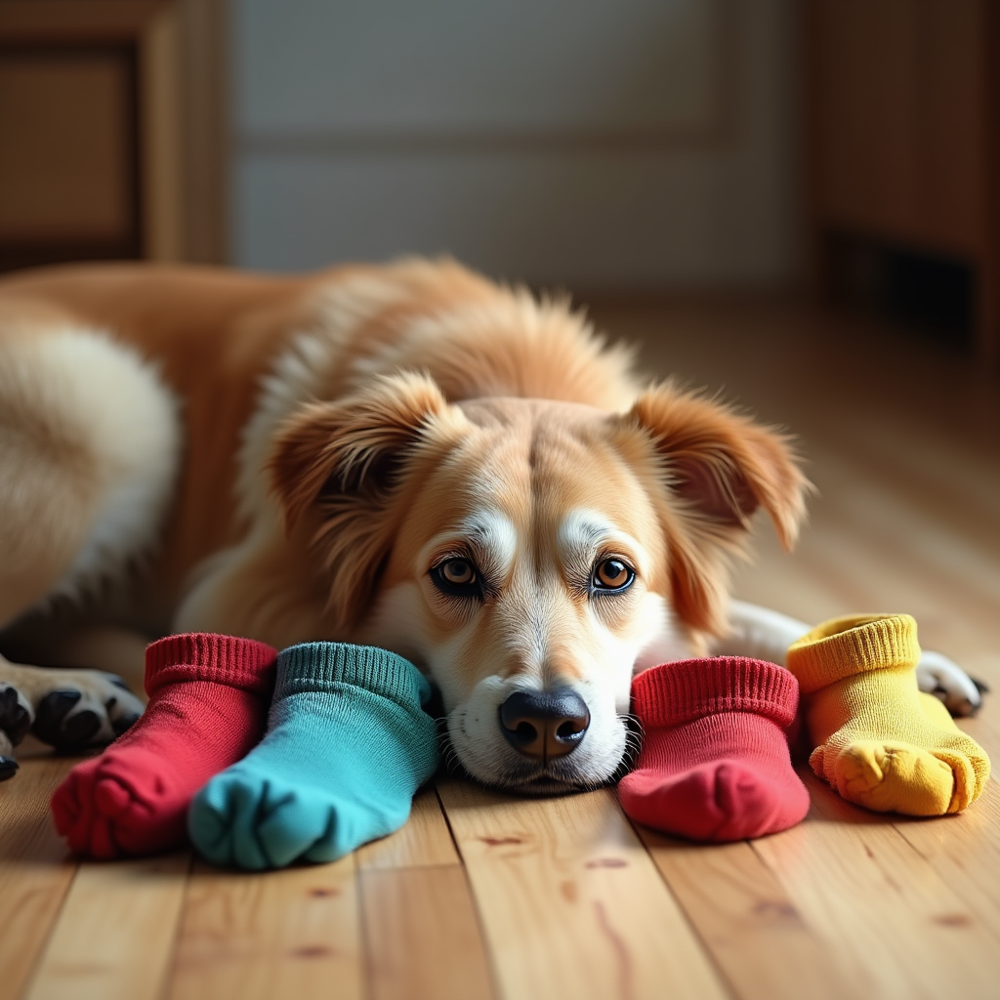

Thinking: <think>
The model should generate an image where the dog is positioned to the right of the socks, clearly showing spatial arrangement.
The complete, polished prompt is: A cozy indoor scene featuring a relaxed dog lying down to the right of a neatly arranged pile of colorful socks. The dog appears calm and comfortable, with soft fur and a gentle expression, while the socks are vibrant and varied in color, including shades of red, blue, green, and yellow, placed on a clean, wooden floor. The lighting is warm and natural, creating a homely atmosphere, with subtle shadows adding depth to the composition. The image is ultra-realistic, with fine details in the textures of the dog's fur, the fabric of the socks, and the wood grain of the floor, ensuring a lifelike and inviting depiction.
</think>


In [17]:
prompt = 'A dog lying down to the right of some socks.'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")

## Orientation 

A motorcycle lying down
----------


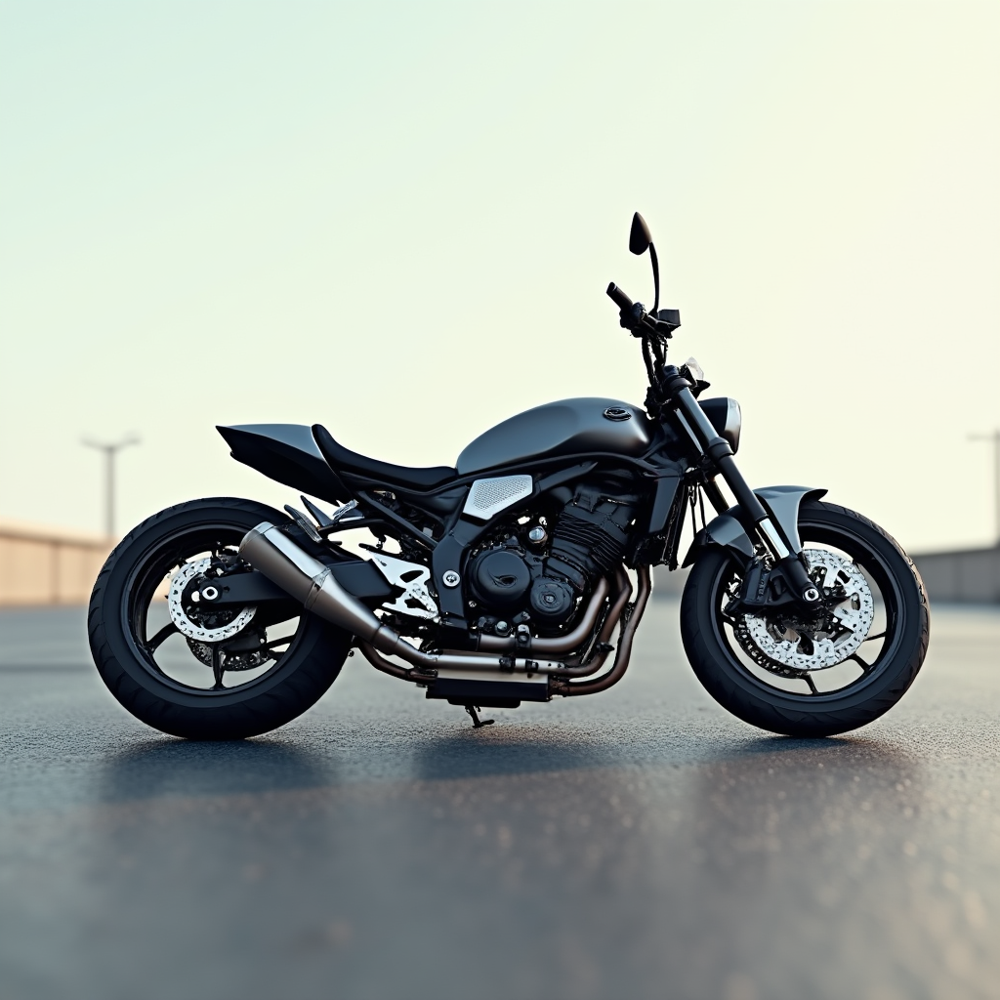

Thinking: <think>
The model should generate an image of a motorcycle that is positioned horizontally on the ground, as if it has fallen over.
Here’s the full, detailed prompt: A sleek, modern motorcycle lying horizontally on the ground, as if it has fallen over, with its wheels and frame clearly visible. The scene is set outdoors on a smooth, flat surface, such as asphalt or concrete, under natural daylight with soft shadows. The motorcycle is detailed and realistic, showcasing its design, including the tires, handlebars, and bodywork. The overall atmosphere is neutral and unobtrusive, focusing entirely on the fallen motorcycle without any distractions. Ultra-realistic rendering with sharp details and balanced lighting.
</think>


In [25]:
prompt = 'A motorcycle lying down'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")

A bell pepper laying on its side
----------


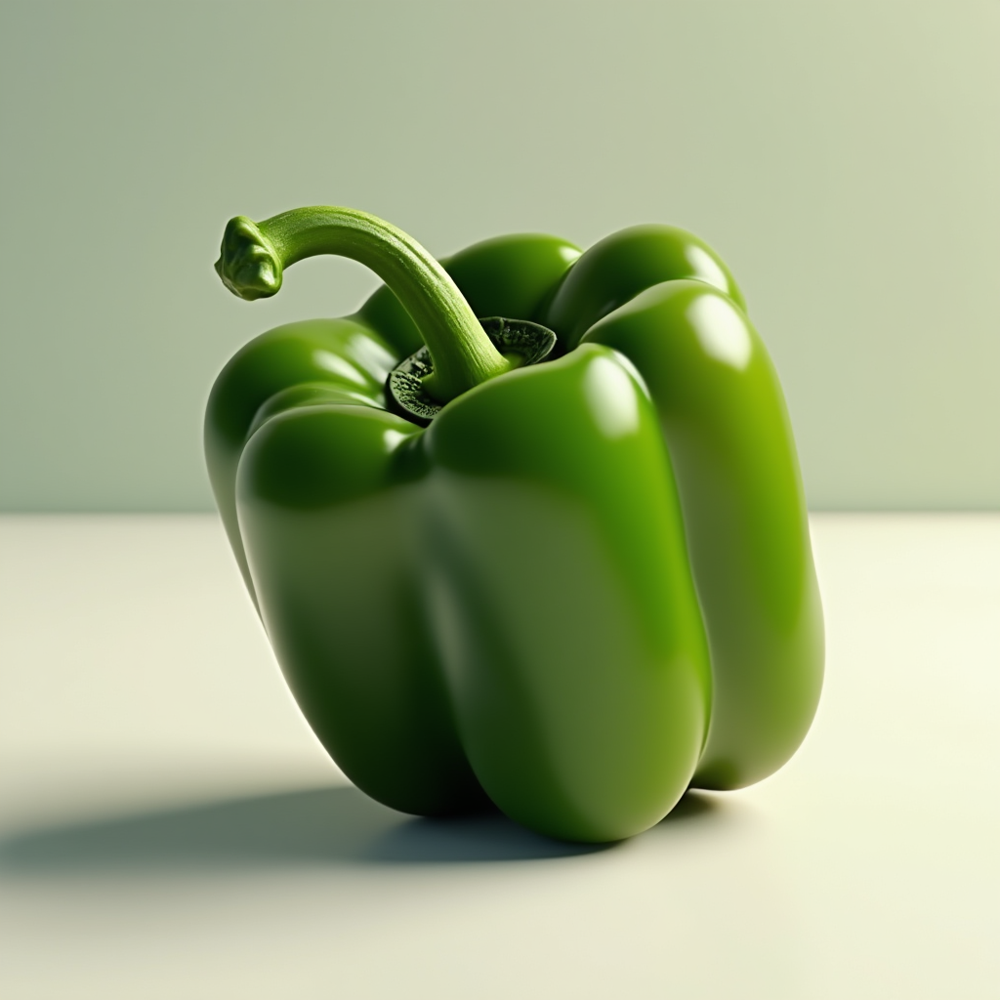

Thinking: <think>
The model should generate an image of a bell pepper lying horizontally on a flat surface, with its curved shape and smooth texture clearly visible.
Here’s the expanded prompt: A vibrant, ripe bell pepper lying horizontally on a smooth, flat surface, showcasing its curved shape and smooth texture in vivid detail. The pepper is brightly colored, with rich green tones and subtle highlights that emphasize its glossy surface. The lighting is soft and natural, creating gentle shadows and reflections that enhance the realism of the scene. The background is minimal and unobtrusive, ensuring full focus on the bell pepper. Ultra-realistic rendering with sharp details and lifelike textures.
</think>


In [28]:
prompt = 'A bell pepper laying on its side'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")

A spider flipped over
----------


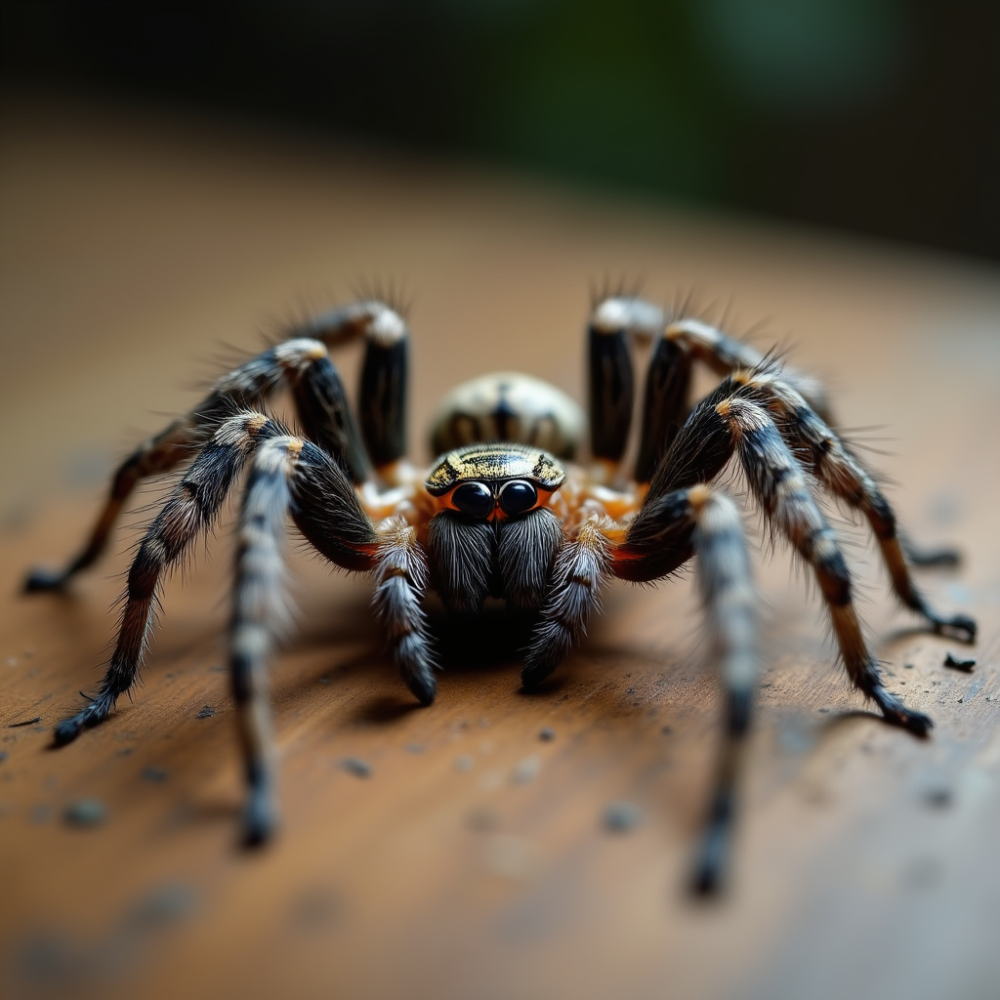

Thinking: <think>
The model should generate an image of a spider lying on its back, with its legs spread out in a relaxed position, showcasing the underside of its body.
Here’s the full, detailed prompt: A close-up, ultra-realistic image of a spider lying on its back, its legs spread out in a relaxed position, revealing the intricate underside of its body. The spider is positioned on a natural surface, such as a wooden table or leaf, with soft, diffused lighting that highlights the fine details of its anatomy, including the texture of its legs and the delicate patterns on its abdomen. The atmosphere is calm and natural, with a shallow depth of field creating a subtle bokeh effect in the background, ensuring the spider remains the central focus.
</think>


In [ ]:
prompt = 'A spider flipped over'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")

## Text

A digital alarm clock showing 6am
----------


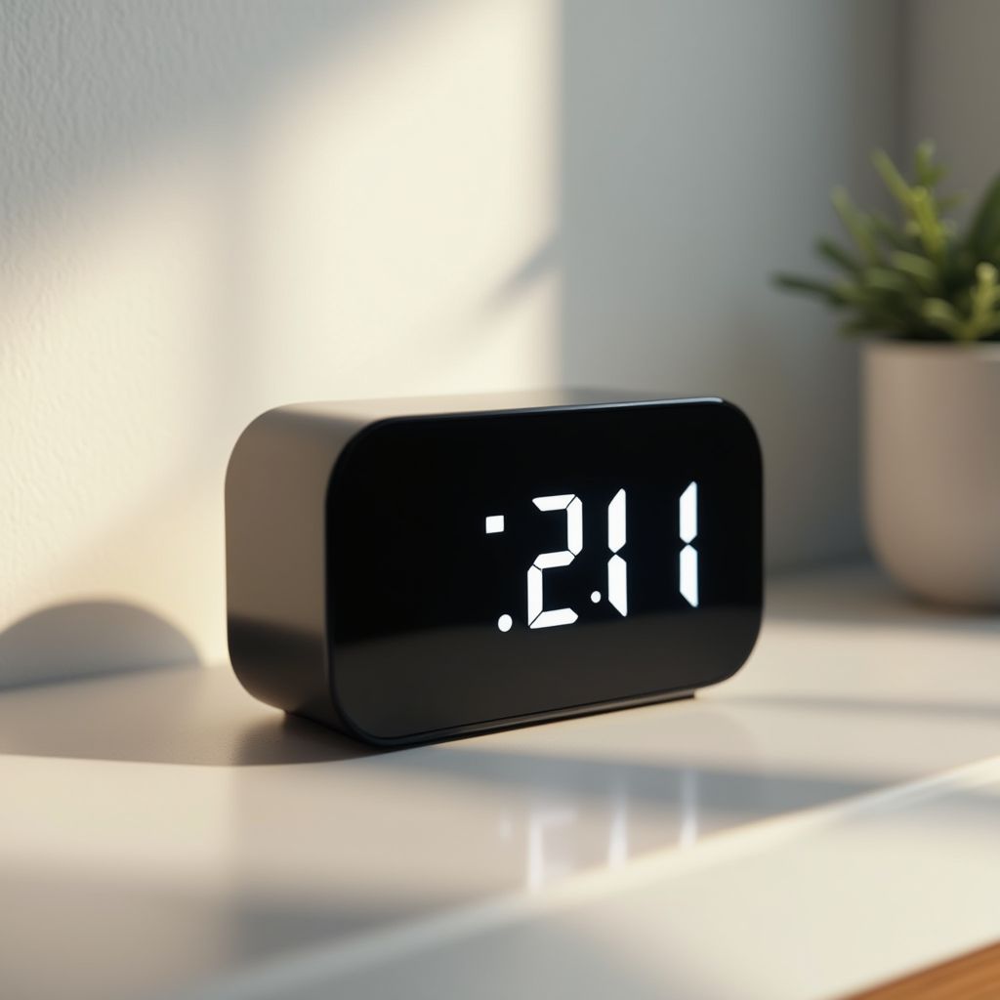

Thinking: <think>
The model should generate an image of a digital alarm clock with the time displayed as 6:00 AM, indicating the morning.
Here’s the finished detailed prompt: A sleek, modern digital alarm clock with a clean, minimalist design, displaying the time as 6:00 AM in bright, clear white numerals on a black background. The clock is placed on a smooth, neutral-colored surface, such as a wooden table or a white countertop, with soft, natural lighting creating a calm morning atmosphere. The image should feel crisp and ultra-realistic, with subtle reflections on the clock’s surface and a slight glow from the digital display to emphasize the time. The overall mood is serene and focused, capturing the essence of a quiet morning.
</think>


In [39]:
prompt = 'A digital alarm clock showing 6am'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")

A highway sign showing 60 MPH
----------


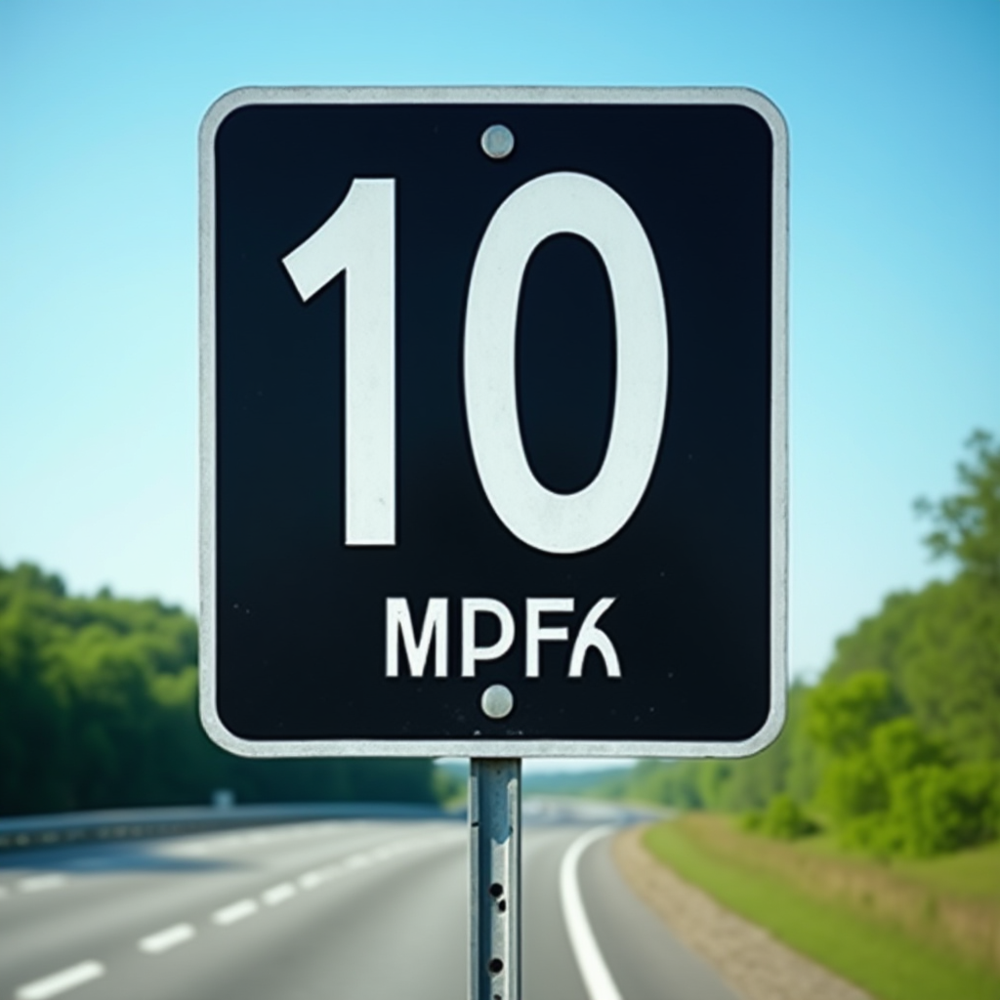

Thinking: <think>
The model should generate an image of a road sign with the number '60' prominently displayed, accompanied by the text 'MPH' to indicate the speed limit in miles per hour.
Here’s the full, detailed prompt: A clear and detailed image of a road sign displaying the number '60' prominently in bold, white font against a black background, with the text 'MPH' directly below in smaller white font. The sign is mounted on a standard metal post, set against a realistic outdoor highway scene with blurred greenery and a clear blue sky in the background, ensuring the sign is the focal point. The lighting is natural and bright, suggesting daytime, with a crisp and clean aesthetic to emphasize clarity and precision.
</think>


In [37]:
prompt = 'A highway sign showing 60 MPH'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")

A magazine cover with the title: Home Interiors
----------


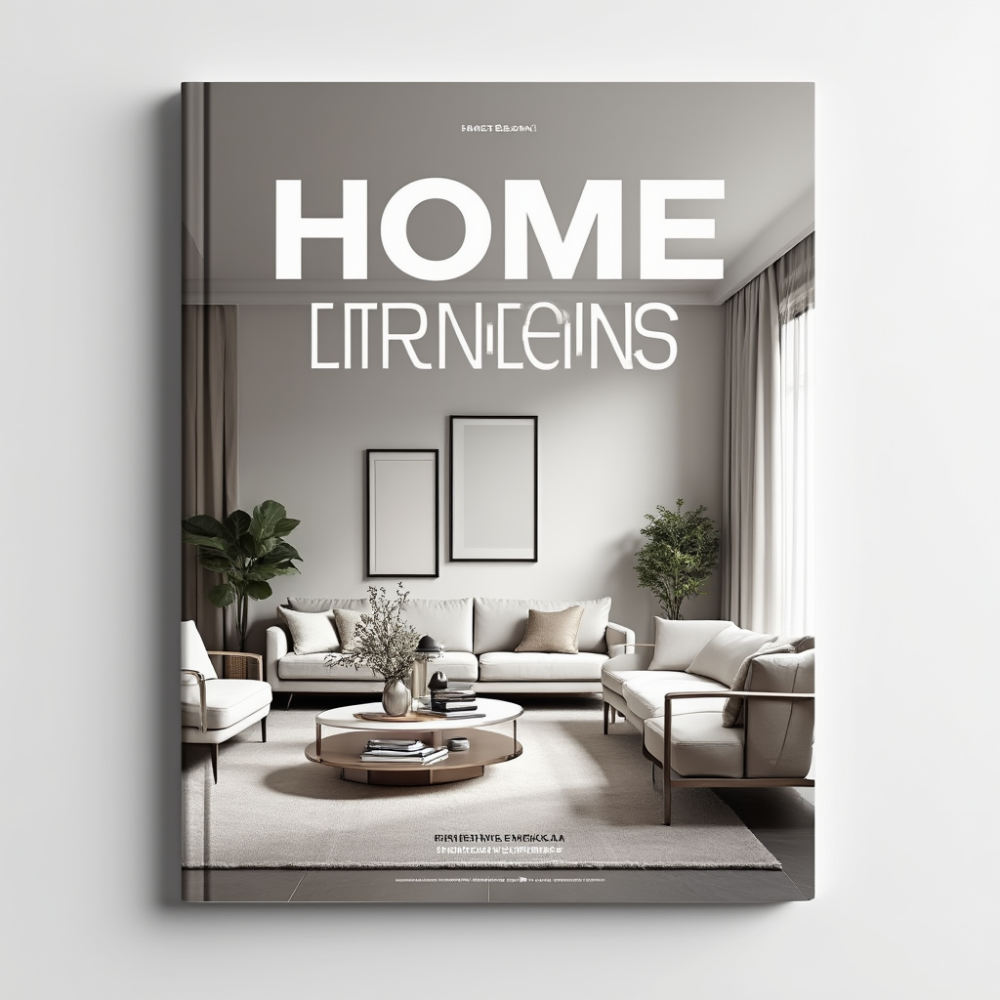

Thinking: <think>
The model should generate an image of a magazine cover featuring a modern and stylish interior design, showcasing furniture, decor, and a clean layout.
The comprehensive prompt is: A modern and stylish magazine cover featuring a clean and sophisticated interior design, showcasing contemporary furniture, elegant decor, and a minimalist layout. The cover should have a sleek, glossy finish with a neutral color palette, including soft whites, grays, and subtle metallic accents. The title "Home Interiors" is prominently displayed in a clean, modern font, with a polished and professional appearance. The image should feel inviting and luxurious, with a focus on high-quality materials and precise detailing, evoking a sense of sophistication and modern elegance. The lighting is soft and evenly distributed, highlighting the textures and contours of the furniture and decor, creating a balanced and visually appealing composition.
</think>


In [ ]:
prompt = 'A magazine cover with the title: Home Interiors'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")

A book cover with the title: "Animals"
----------


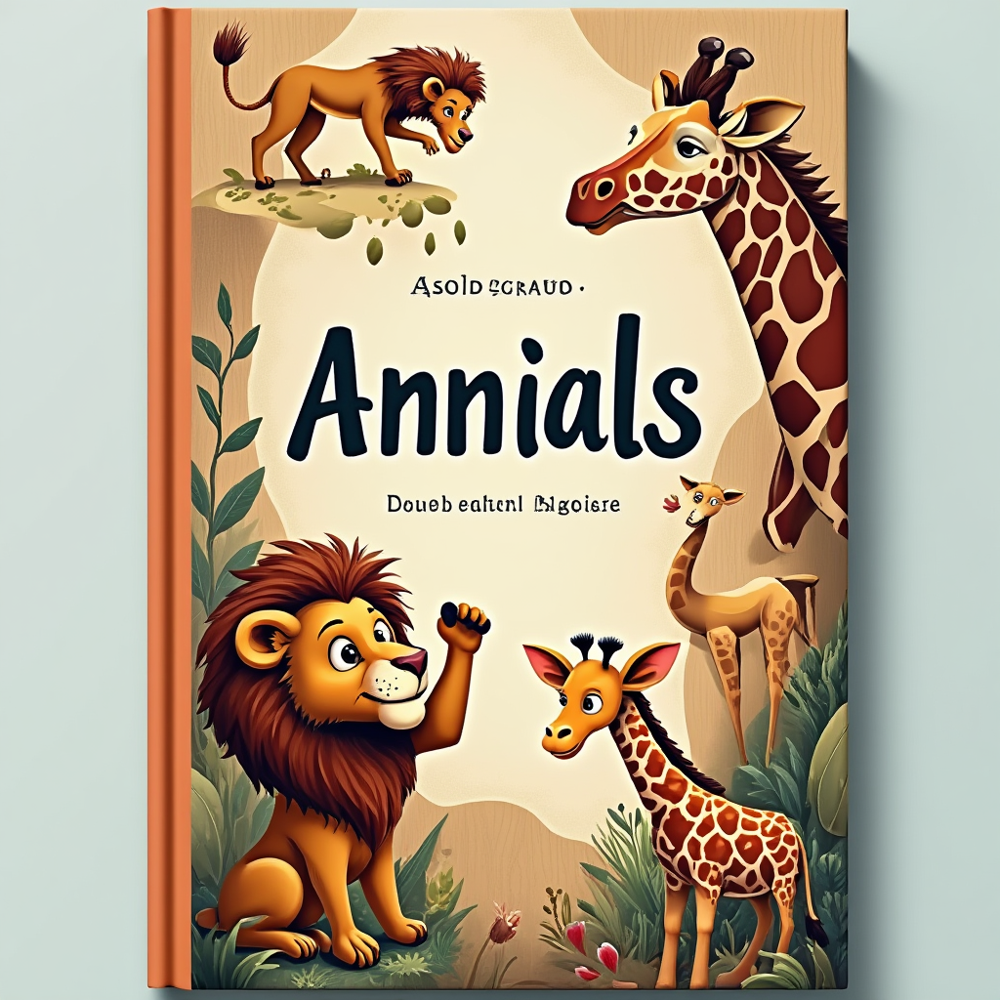

Thinking: <think>
The model should generate an image of a book cover featuring the word "Animals" prominently displayed, possibly with illustrations or a design related to animals.
The refined prompt is: A vibrant and detailed book cover featuring the word "Animals" prominently displayed in bold, modern typography, with a clean and eye-catching design. The cover includes illustrations of various animals, such as a playful lion, a curious monkey, and a graceful giraffe, arranged in a harmonious composition. The background is a warm, earthy tone with subtle textures resembling natural materials like wood or stone, evoking a sense of connection to wildlife. The overall aesthetic is engaging and educational, with a balanced blend of realism and artistic flair, suitable for a children's book. The lighting is soft and inviting, highlighting the vivid colors and intricate details of the illustrations and text.
</think>


In [47]:
prompt = 'A book cover with the title: \"Animals\"'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")

## Cardinality

3 peaches in a fruit basket
----------


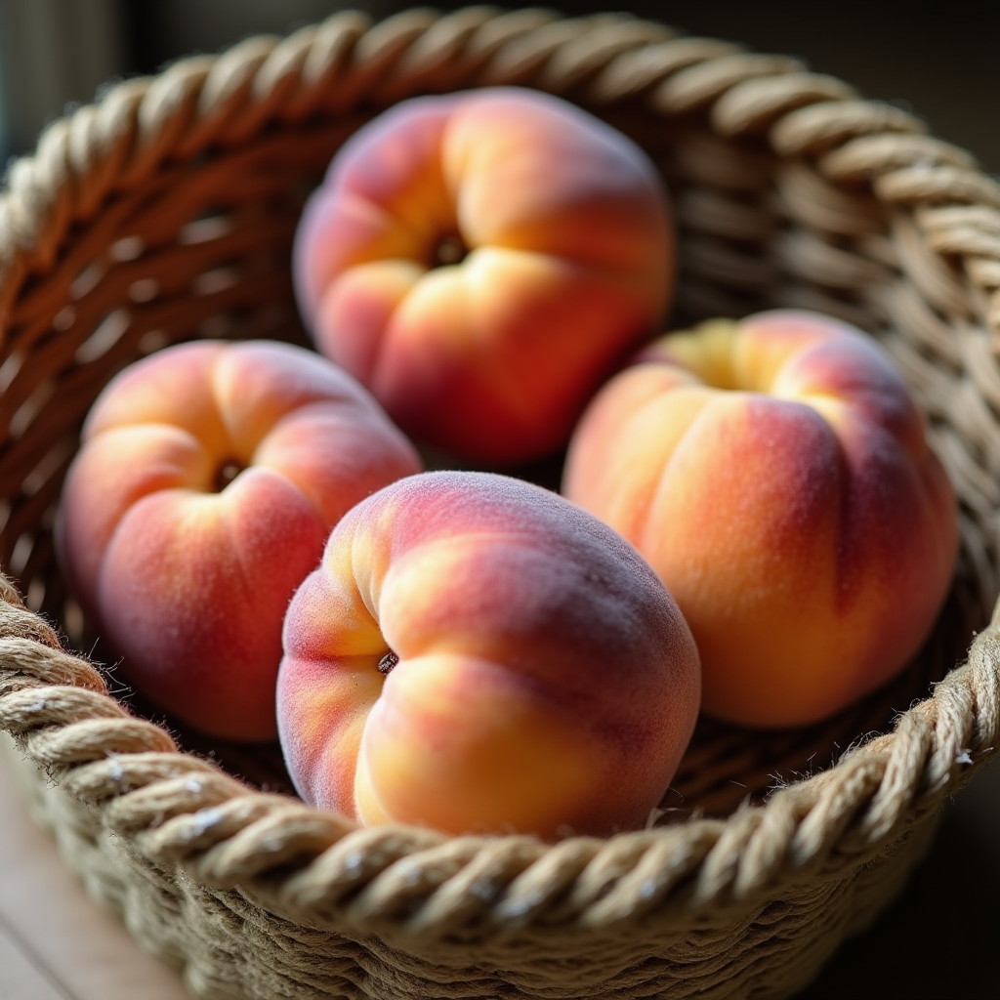

Thinking: <think>
The model should generate an image showing three peaches placed inside a fruit basket, with the peaches appearing ripe and slightly textured, and the basket having a woven or fabric design.
Here’s the full, detailed prompt: Three ripe peaches with a slightly textured surface, placed inside a woven or fabric fruit basket. The peaches are vibrant in color, showcasing a mix of soft orange and pink hues, with natural imperfections and subtle highlights. The basket features a rustic, handcrafted design with visible threads or fibers, creating a warm and organic aesthetic. The scene is softly lit with diffused natural light, emphasizing the peaches' glossy skin and the basket's intricate texture. The overall atmosphere is inviting and earthy, with a focus on realism and detail, captured in a close-up perspective.
</think>


In [49]:
prompt = '3 peaches in a fruit basket'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")

5 birds sitting on a power line
----------


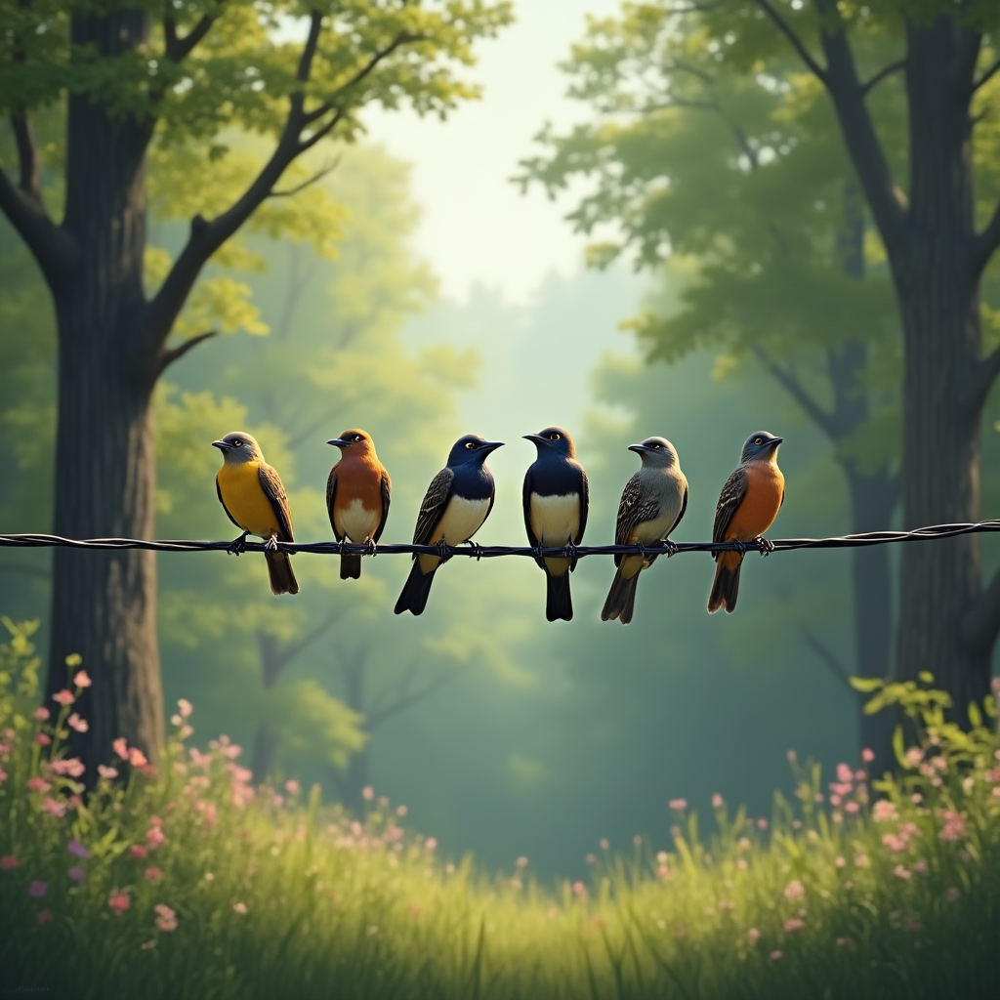

Thinking: <think>
The model should generate an image of five birds perched on a single power line, spaced evenly apart, with the scene set in a natural outdoor environment like a forest or park.
The refined prompt is: Five birds perched evenly spaced on a single power line, each bird distinct in species and color, set against a serene natural outdoor backdrop of a lush forest or park. The scene is bathed in soft, natural daylight with gentle shadows, emphasizing the tranquil atmosphere. The power line stretches horizontally across the frame, with the birds positioned at regular intervals, creating a balanced composition. The surrounding environment features dense green foliage, tall trees, and subtle hints of wildflowers, all rendered in ultra-realistic detail to capture the beauty of the natural setting. The mood is peaceful and harmonious, with a focus on the delicate interplay of light and texture.
</think>


In [52]:
prompt = '5 birds sitting on a power line'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")

A field with 5 deer grazing
----------


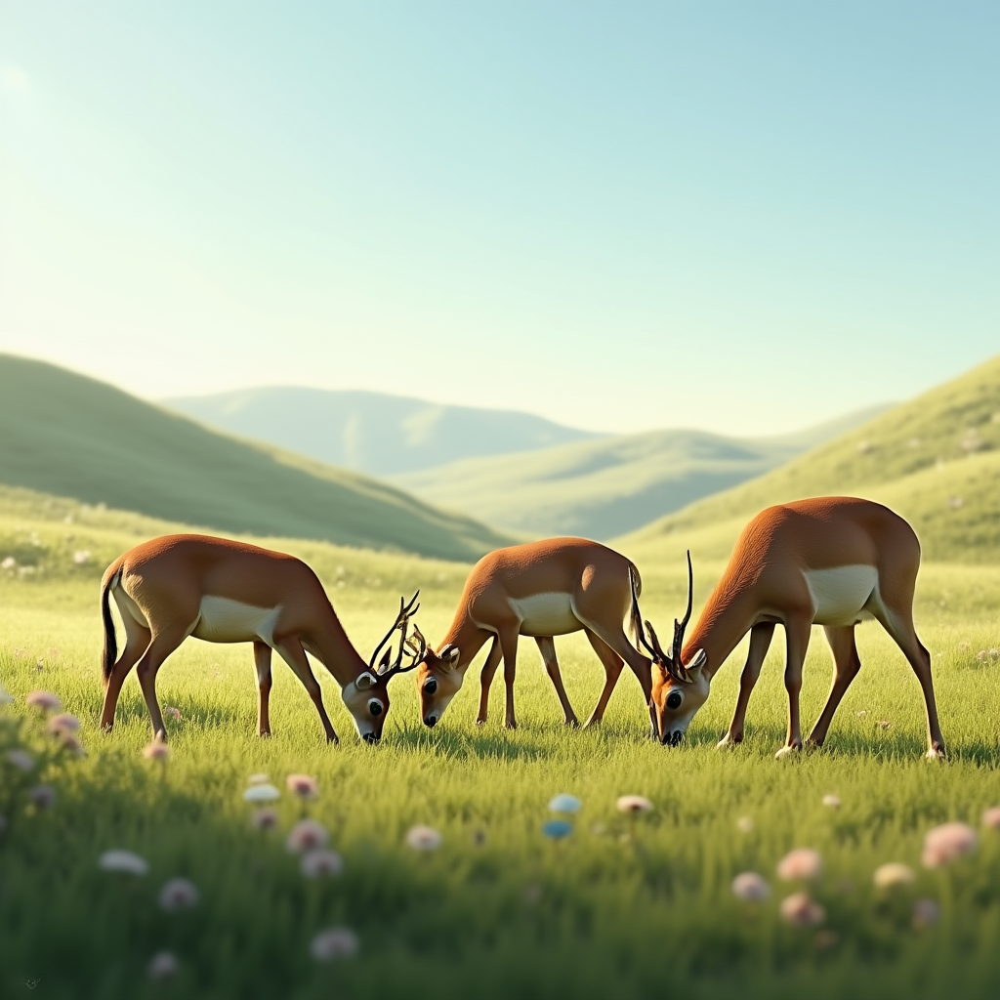

Thinking: <think>
The model should generate an image of a grassy field with 5 deer spread out, grazing peacefully. The scene should reflect a natural, serene environment with no signs of danger or stress.
Here’s the full, detailed prompt: A serene, natural grassy field bathed in soft, warm sunlight, with 5 deer grazing peacefully in a harmonious arrangement. The deer are spread out across the landscape, each engaged in eating the lush green grass, their coats appearing natural and detailed. The scene is tranquil and undisturbed, with no signs of danger or stress, evoking a sense of calm and harmony. The background features gentle rolling hills and a clear blue sky, with subtle hints of wildflowers scattered throughout the field. The lighting is natural and balanced, creating a realistic and inviting atmosphere, with fine details in the textures of the grass, the deer's fur, and the surrounding environment. Ultra-realistic rendering with cinematic lighting and a focus on natural beauty.

In [66]:
prompt = 'A field with 5 deer grazing'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")

A tray of 6 cookies
----------


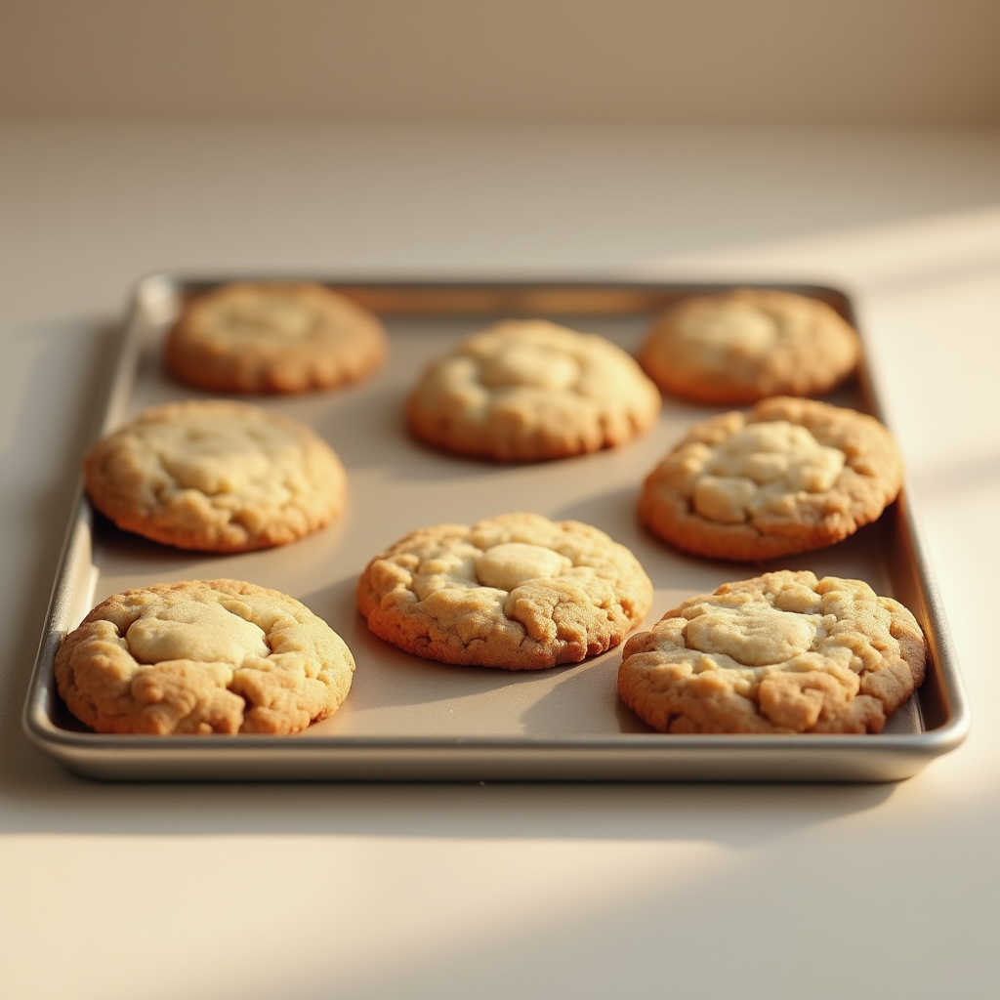

Thinking: <think>
The model should generate an image showing a tray with six cookies evenly spaced, each appearing slightly different in size and shape, demonstrating the concept of variation.
Here’s the full, detailed prompt: A tray of six cookies, each uniquely shaped and sized, arranged evenly across the tray to showcase variation in form and texture. The cookies have a warm, golden-brown color, with subtle imperfections and slight differences in size to emphasize individuality. The tray is simple and neutral, placed on a clean, softly lit surface, with a natural and inviting atmosphere. The lighting is warm and diffused, highlighting the cookies' details and creating a cozy, appetizing mood. Ultra-realistic, with a focus on texture and realism.
</think>


In [72]:
prompt = 'A tray of 6 cookies'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")

## Structural Characteristics

Fresh fruits all cut in half
----------


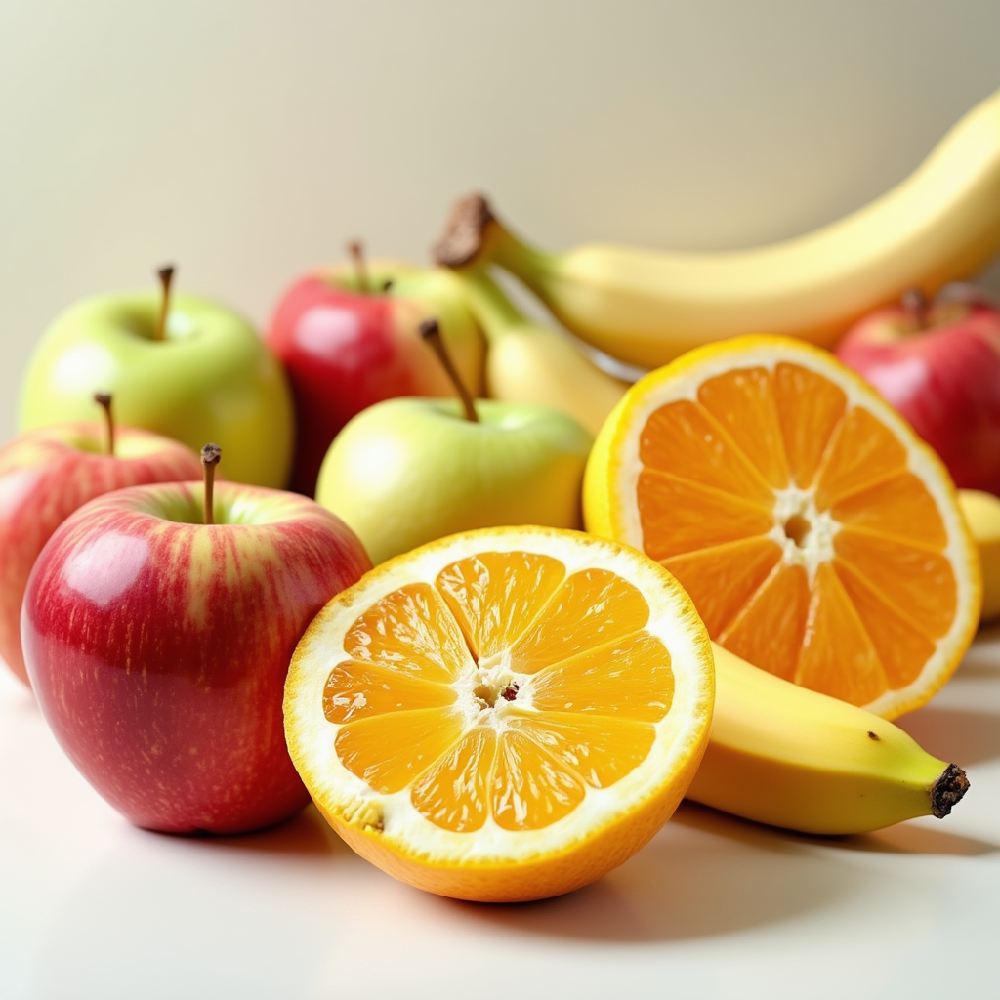

Thinking: <think>
The model should generate an image showing a variety of fruits, such as apples, oranges, and bananas, each cut in half to reveal their inner textures and colors.
The complete, polished prompt is: A vibrant and ultra-realistic image of a variety of fresh fruits, each cut in half to showcase their inner textures and colors. The fruits include apples, oranges, and bananas, arranged neatly on a clean, neutral surface. The apples reveal crisp, juicy flesh with a mix of red and green hues, the oranges display bright, segmented flesh with a vivid orange tone, and the bananas show creamy, pale yellow interiors. The lighting is soft and natural, with gentle shadows and highlights that emphasize the freshness and detail of the fruit. The overall atmosphere is inviting and appetizing, with a focus on the natural beauty and textures of the cut fruits.
</think>


In [53]:
prompt = 'Fresh fruits all cut in half'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")

A piece of paper folded in half
----------


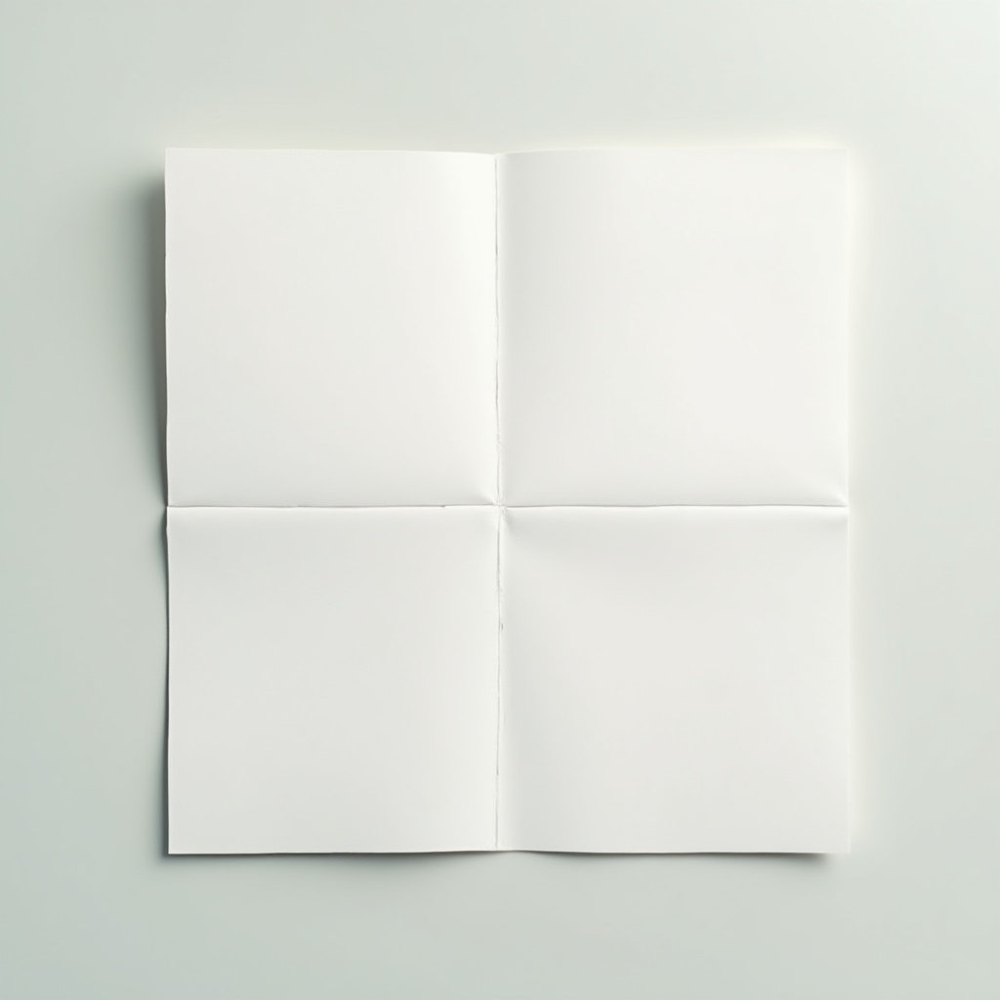

Thinking: <think>
The model should generate an image showing a flat piece of paper that has been folded neatly in half, with the crease clearly visible and the two halves aligned symmetrically.
Here’s the expanded prompt: A flat piece of paper folded neatly in half, with a crisp, clean crease running down the center, showcasing perfect symmetry. The paper is smooth and slightly textured, with a neutral white or light pastel color, resting on a minimalistic, softly lit surface. The lighting is even and diffused, creating a calm and neutral atmosphere, with no distracting elements in the background. Ultra-realistic details emphasize the paper's texture and the sharpness of the crease, ensuring a clean and precise visual presentation.
</think>


In [63]:
prompt = 'A piece of paper folded in half'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")

A bent knife
----------


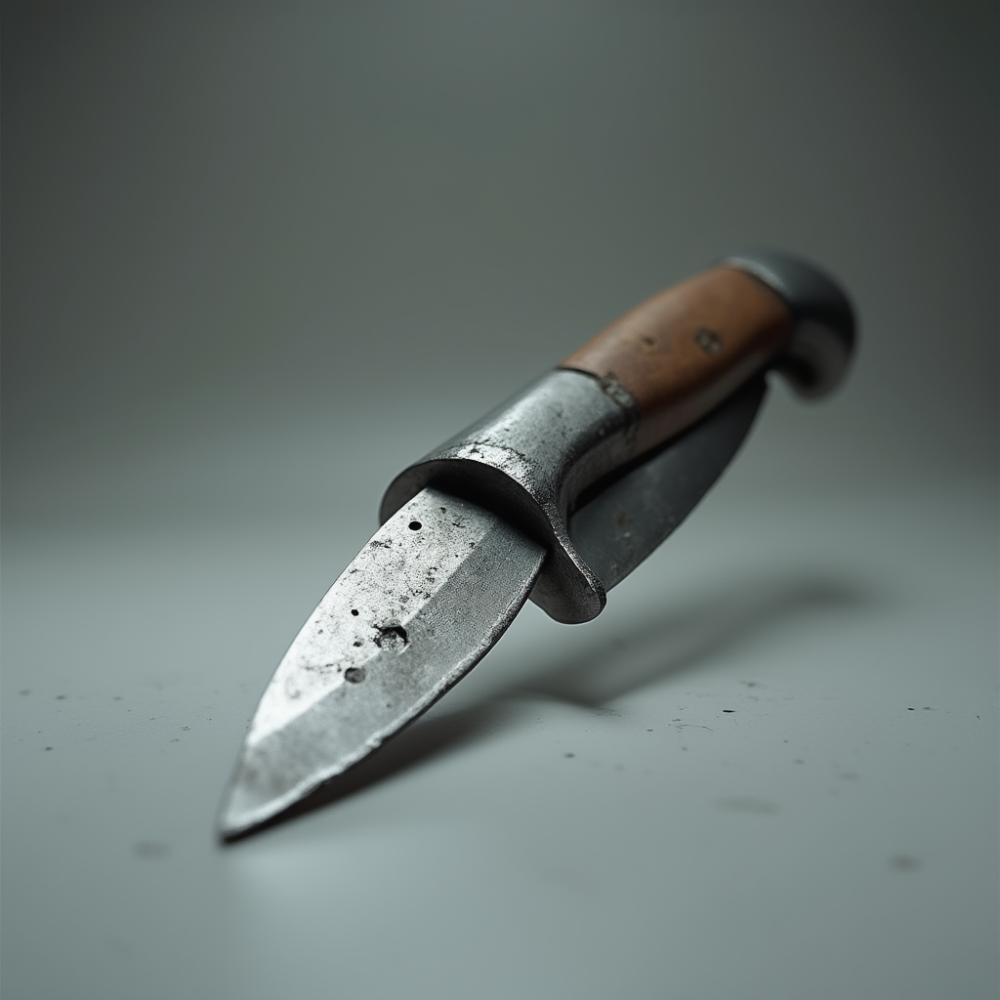

Thinking: <think>
The model should generate an image of a knife with a visibly bent or deformed blade, showing signs of physical stress or damage.
Here’s the full, detailed prompt: A close-up, ultra-realistic image of a knife with a visibly bent or deformed blade, showcasing clear signs of physical stress and damage. The blade appears misshapen, with sharp edges and a rough texture, while the handle remains intact and functional. The setting is neutral, with a simple background to emphasize the knife, and soft, diffused lighting highlights the details of the bent metal and its imperfections. The atmosphere is clinical and focused, with a sharp focus on the knife and a slight bokeh effect in the background for added depth.
</think>


In [64]:
prompt = 'A bent knife'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")

A car with a dented door
----------


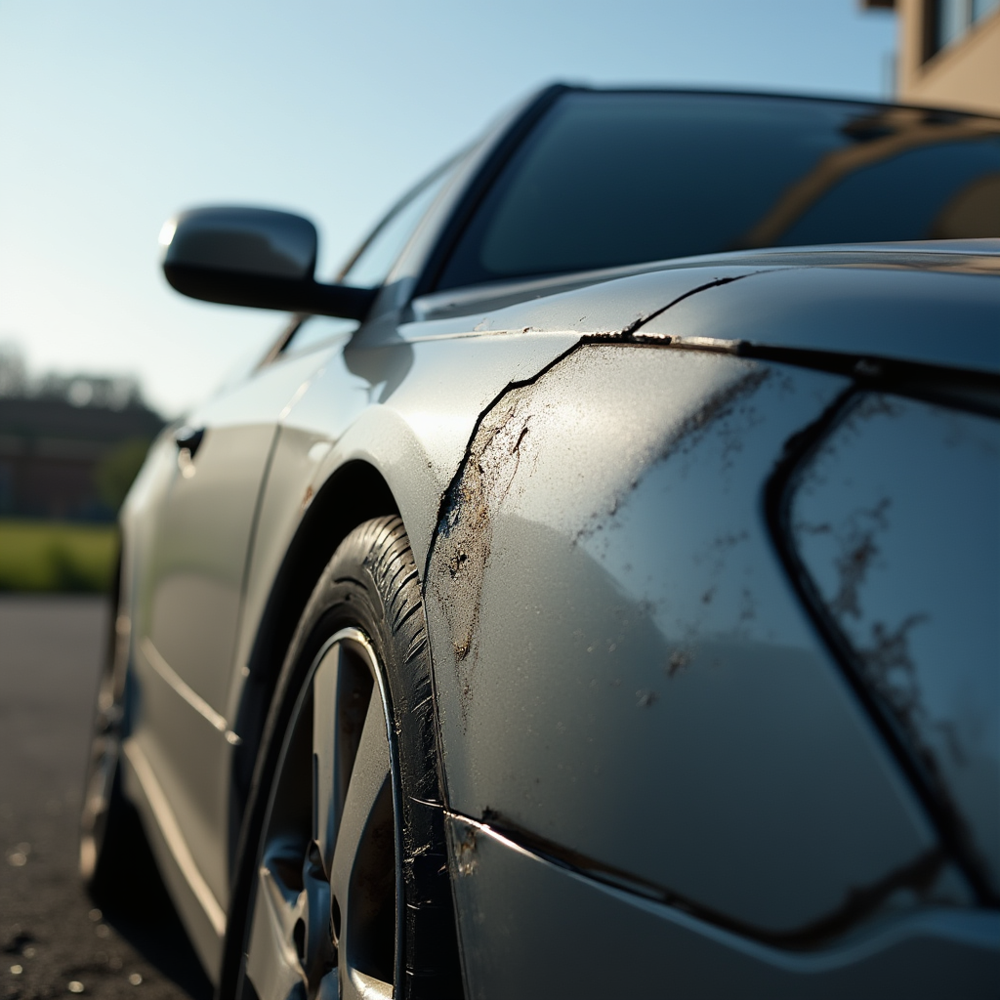

Thinking: <think>
The model should generate an image of a car with a visibly dented door, showing the deformation and potential damage to the surrounding area, such as the adjacent panels or paintwork.
The complete, polished prompt is: A close-up view of a car with a visibly dented door, showcasing the deformation and damage to the surrounding area, including adjacent panels and paintwork. The dents are realistic and detailed, with visible scratches and cracks in the paint. The car is parked in a well-lit outdoor setting, with natural daylight highlighting the texture of the metal and paint. The scene is ultra-realistic, with sharp focus on the damaged area and subtle reflections on the car's surface, emphasizing the severity of the damage.
</think>


In [67]:
prompt = 'A car with a dented door'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")

A deflated tire
----------


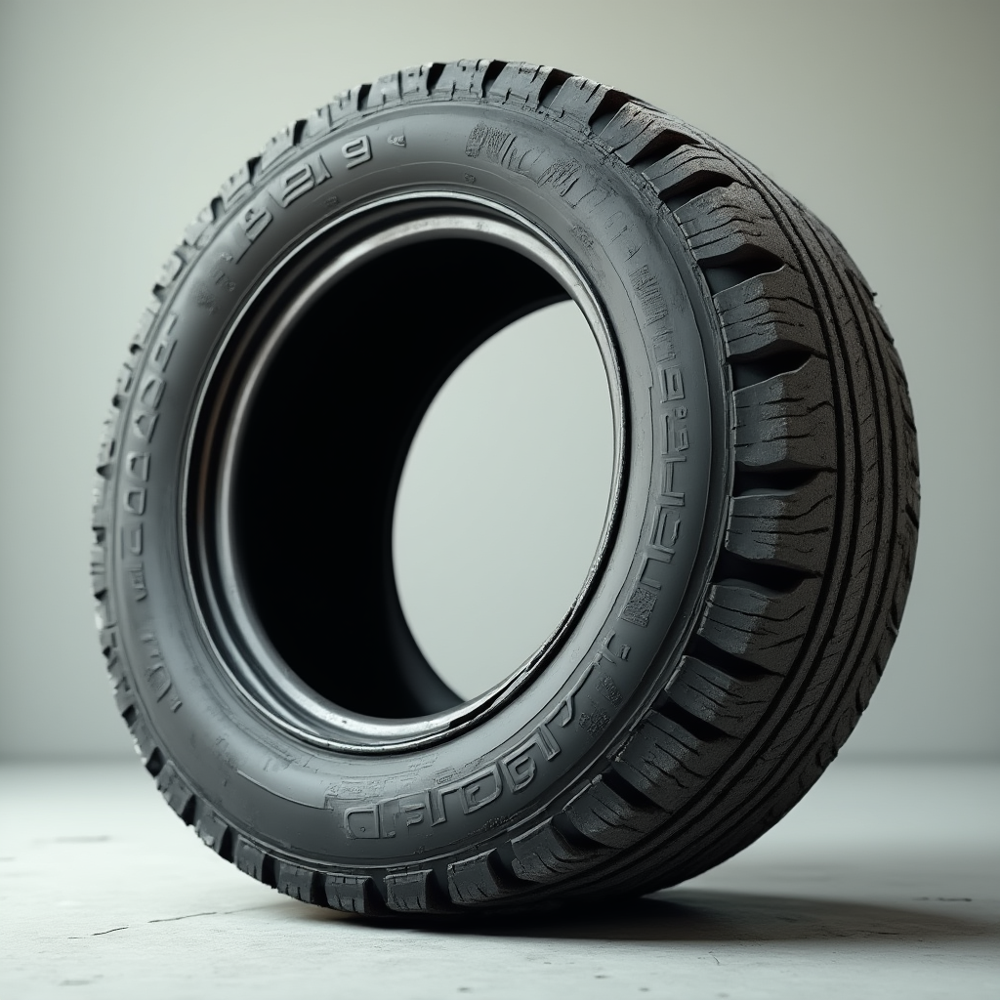

Thinking: <think>
The model should generate an image of a tire that is visibly flat, with no air pressure, showing the inner structure and tread pattern clearly.
The complete, polished prompt is: A close-up, ultra-realistic image of a deflated tire, showcasing its inner structure and tread pattern in vivid detail. The tire is visibly flat, with no air pressure, and the rubber material appears worn and textured. The lighting is soft and natural, highlighting the intricate details of the tire's surface, including the grooves and imperfections. The background is minimal and slightly blurred, ensuring the focus remains entirely on the tire. The atmosphere is neutral and clean, with a subtle matte finish on the tire to emphasize its worn condition.
</think>


In [76]:
prompt = 'A deflated tire'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")

A butterfly with its wings closed
----------


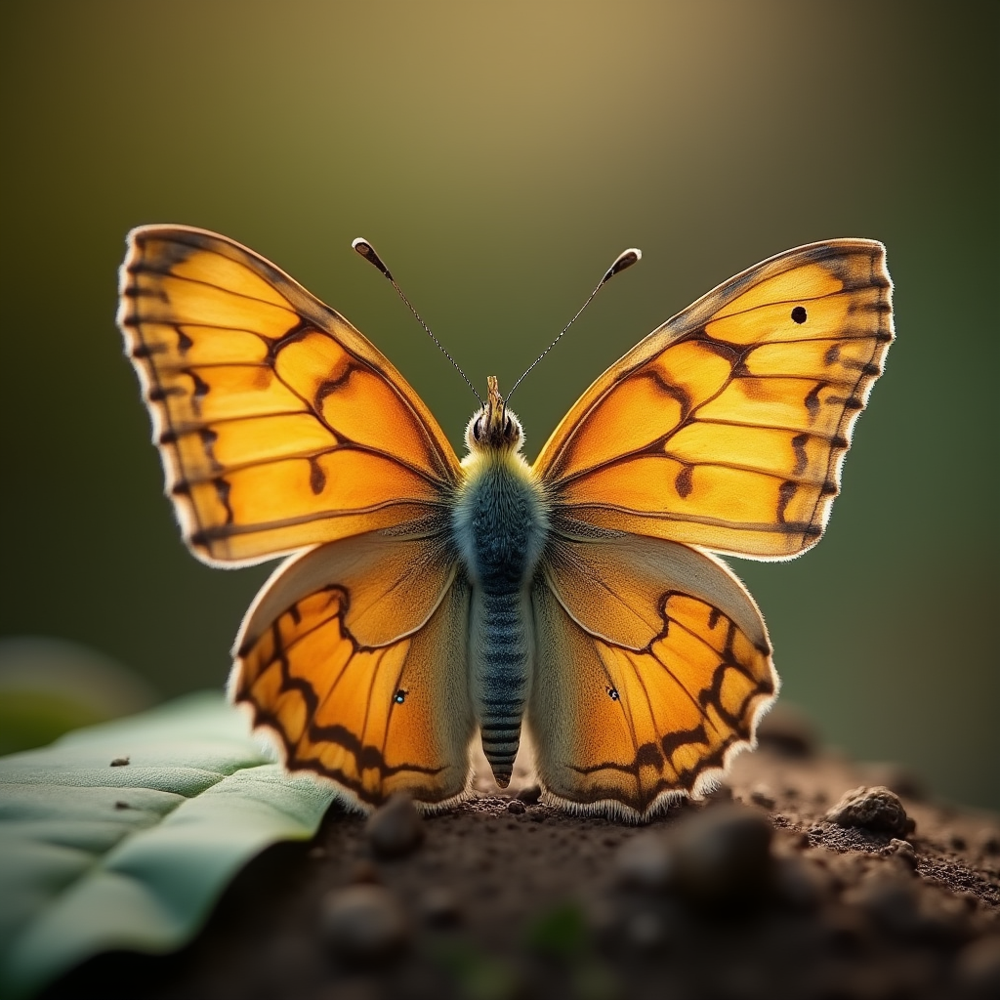

Thinking: <think>
The model should generate an image of a butterfly with its wings folded together, showcasing a resting position. The image should highlight the delicate structure of the wings and the body.
Here’s the expanded prompt: A close-up, ultra-realistic depiction of a butterfly in a resting position with its wings folded together, showcasing the intricate and delicate structure of the wings and body. The butterfly is perched on a natural surface, such as a leaf or branch, surrounded by soft, natural lighting that emphasizes the fine details and textures of its wings. The background is softly blurred with a shallow depth of field, creating a serene and harmonious atmosphere, with warm, earthy tones and a gentle, natural color palette.
</think>


In [74]:
prompt = 'A butterfly with its wings closed'
print(prompt)
print('-' * 10)
output_dict = inferencer(text=prompt, **t2i_think_params)
display(output_dict['image'])
print(f"Thinking: {output_dict['text']}")